# Q1 - COVID19

**Utah as selected country**

### **a. Show COVID-19 spread in selected country**

**in this demo**

> we start by measure the covid-19 spread over time.

> we will start by import raw data from kaggle from all the USA states and filter it by Utah.

**With limitless resources:**


I will create graph of all the events of corona in the city, the nodes will be report about new death rate or cases and the location and the link will be by time diffrence so it will be dircted graph and each link will be conected if the event come day after the previous event. after that I will be able to ditect shortest path from events in diffrent citys and estimate how mach days took the corona virous to spread from city to city, in addtion I can see how mach time took to spread all over the state. the data can be collected by scraping social networks and check reports of news, ditect word that conencted to the covid-19 and dictect date and numbers.
This graph can show in addtion index 1.

In addtion to save and update all the data I will use AWS streams with spark with S3 Storage Service just becouse I can :)



In [ ]:
!pip uninstall plotly
!pip install plotly

In [ ]:
# Installing the Kaggle package
import json
!pip install kaggle 
!mkdir /root/.kaggle/

#Important Note: complete this with your own key - after running this for the first time remmember to **remove** your API_KEY
api_token = ""

# creating kaggle.json file with the personal API-Key details 
# You can also put this file on your Google Drive
with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

In [ ]:
!mkdir ./datasets
!kaggle datasets download -d sudalairajkumar/covid19-in-usa -p ./datasets
#!kaggle datasets download -d lsind18/gemstones-images -p ./datasets
!unzip ./datasets/*.zip  -d ./datasets/



> show deaths and cases over time



In [25]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm import tqdm

read data and filter by Utah

In [ ]:
df_deaths_cases = pd.read_csv("./datasets/us_counties_covid19_daily.csv")
df_deaths_cases_filterd = df_deaths_cases[df_deaths_cases["state"] == "Utah"]
df_deaths_cases_filterd['date'] = df_deaths_cases_filterd['date'].astype('datetime64[ns]')


each raw in our table show case and state so we need to group by state and sum the cases to show total cases per day

In [27]:
df_deaths_cases_filterd = df_deaths_cases_filterd.groupby(['date']).sum()
df_deaths_cases_filterd['day'] = df_deaths_cases_filterd.index.day
df_deaths_cases_filterd['month'] = df_deaths_cases_filterd.index.month 


plot

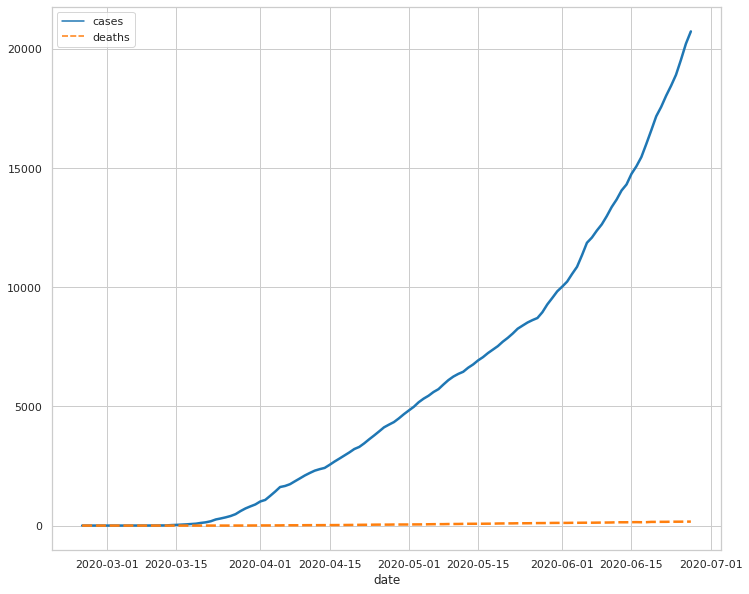

In [28]:
sns.set(style="whitegrid")
fig, ax = plt.subplots(figsize=(12,10))

sns.lineplot(ax =ax ,data=df_deaths_cases_filterd[["cases","deaths"]], palette="tab10", linewidth=2.5)


now we can create comaration between death and cases in with city seperation!

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


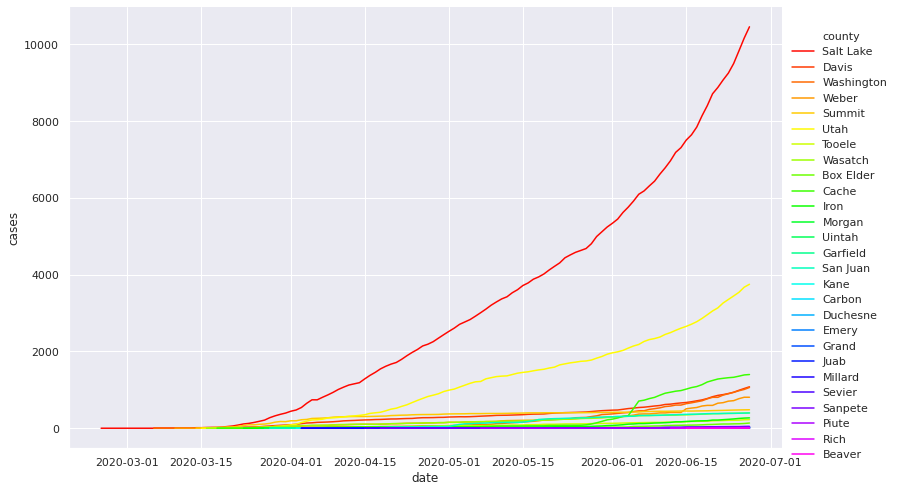

In [29]:
df_deaths_cases_filterd = df_deaths_cases[df_deaths_cases["state"] == "Utah"]
df_deaths_cases_filterd['date'] = df_deaths_cases_filterd['date'].astype('datetime64[ns]')
df_deaths_cases_filterd =  df_deaths_cases_filterd[df_deaths_cases_filterd["county"] != 'Unknown']
sns.set(style="darkgrid")

palette = dict(zip(df_deaths_cases_filterd.county.unique(),
                   sns.color_palette("gist_rainbow", len(df_deaths_cases_filterd.county.unique()))))

sns.relplot(x="date", y="cases",
            hue="county",
             palette=palette,
            height=7, aspect=1.6, facet_kws=dict(sharex=False),
            kind="line", legend="full", data=df_deaths_cases_filterd)

and by deaths..

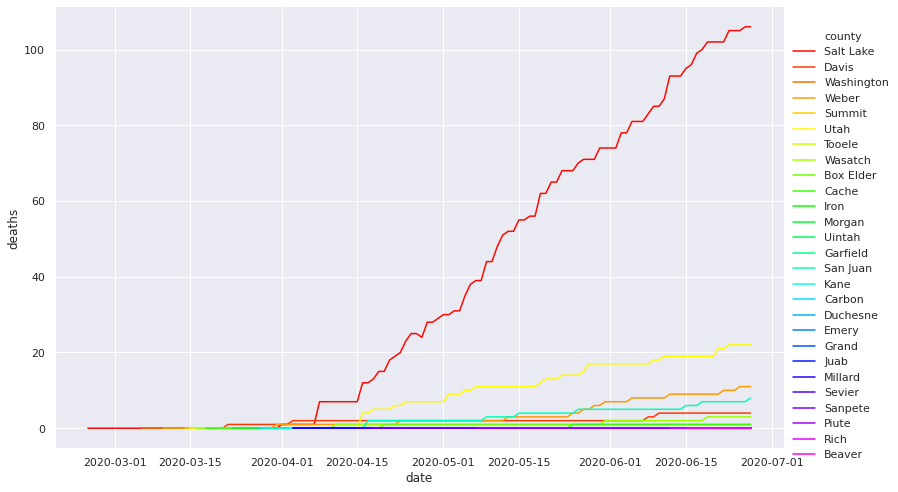

In [30]:
sns.relplot(x="date", y="deaths",
            hue="county",
             palette=palette,
            height=7, aspect=1.6, facet_kws=dict(sharex=False),
            kind="line", legend="full", data=df_deaths_cases_filterd)


> show in map with GIF




In [ ]:
!mkdir images
!pip install psutil requests
!pip install plotly>=4.0.0
!wget https://github.com/plotly/orca/releases/download/v1.2.1/orca-1.2.1-x86_64.AppImage -O /usr/local/bin/orca
!chmod +x /usr/local/bin/orca
!apt-get install xvfb libgtk2.0-0 libgconf-2-4

In [59]:
import numpy as np
from tqdm import tqdm
import plotly.express as px
import matplotlib.pyplot as plt
from urllib.request import urlopen
import json

with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

df_deaths_cases_filterd['fips'] = df_deaths_cases_filterd['fips'].astype('int')
df_deaths_cases_filterd['date'] = df_deaths_cases_filterd['date'].astype(str)




allYears = np.sort(df_deaths_cases_filterd["date"].unique())
paths = []
for year in tqdm(allYears):
  yearData = df_deaths_cases_filterd[df_deaths_cases_filterd["date"] == year]
  fig = px.choropleth_mapbox(yearData, geojson=counties, locations='fips', color='cases',
                            color_continuous_scale="Viridis",
                            range_color=(0, 12),
                            mapbox_style="carto-positron",
                            opacity=0.5,
                            labels={'cases':'cases K'},
                          )
  fig.update_layout(mapbox_zoom=5, mapbox_center = {"lat" : 39.420251,"lon": -111.668110}
                  ,font=dict(
                      family="Courier New, monospace",
                      size=10,
                      color="#7f7f7f"
                      ),
                  title={
                      'text': "The date: " + str(year),
                      'y':0.9,
                      'x':0.5,
                      'xanchor': 'center',
                      'yanchor': 'top',},
                  width=600,
                  height=500,
                  )
  fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
  path = f"images/fig{year}.png"
  fig.write_image(path)
  paths.append(path)

100%|██████████| 124/124 [09:36<00:00,  4.65s/it]


In [60]:
import imageio
images = []
for filename in paths:
    images.append(imageio.imread(filename))
imageio.mimsave("./images/all_year.gif", images, duration=1 )

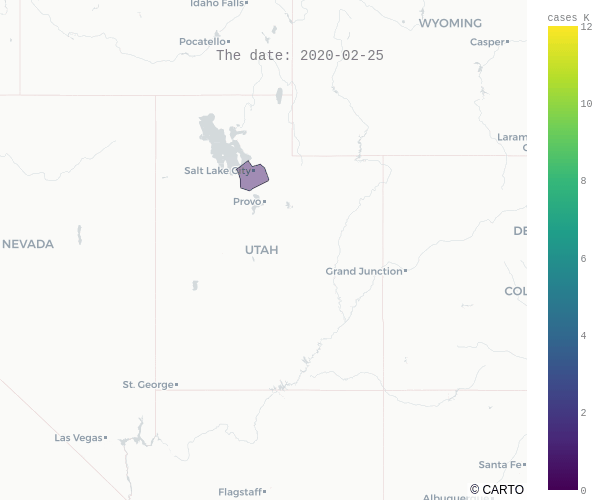

In [61]:
from IPython.display import Image
Image('./images/all_year.gif', format='png')

I can do the same thing with deaths but I didnt include it in the demo

### **b. citizens mood**


In this quotation I created emotion extraction from redit comments on conid-19,utah posts to understand the pepole filling.

**With limitless resources:**

I will use sentiement analysis to extract the emotions from the post title and the comments. for the plot part I will show the emotion power among all the convid 19 area and see if I can see some corealations for the emotions and the deaths or cases.

In addtion I can check if more posstive or negative comments got more score in the redit website, I can assume that score will show the identification of utah community.

Another plot I could do is map that show the emotion over time in each city by get location from user in the redit or search the name in facebook or another social media network and extreact living location.

In this demo we will take one dimention of this reasearch and check the unemployment rate changes over time.

**for this demo I will show:**

*   geting only titles from redit api
*   activate sentiement analysis
*   show graph of the emotions over time and examin the connectio to the deaths or cases












I create redit key as a developer and now I have acecess to the API, I will start with reading the exmple page about the covid-19 and Utah

In [ ]:
!pip install -U textblob
!pip install afinn
!python -m textblob.download_corpora
!pip install praw

In [ ]:
import praw
import pandas as pd
import datetime as dt
import re
from textblob import TextBlob
from textblob.sentiments import NaiveBayesAnalyzer
from tqdm import tqdm_notebook
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

reddit = praw.Reddit(client_id='', \
                     client_secret='', \
                     user_agent='', \
                     username='', \
                     password='')

In [ ]:
posts = []
ml_subreddit = reddit.subreddit('utah')
for post in ml_subreddit.hot(limit=1000):
    posts.append([post.title, post.score, post.id, post.subreddit, post.url, post.num_comments, post.selftext, post.created])
posts = pd.DataFrame(posts,columns=['title', 'score', 'id', 'subreddit', 'url', 'num_comments', 'body', 'created'])


we need to change the creation time to be dataframe.time type

In [ ]:
def get_date(created):
    return dt.datetime.fromtimestamp(created)
_timestamp = posts["created"].apply(get_date)
posts = posts.assign(timestamp = _timestamp)

now we can start to work on the sentiment analysis

In [ ]:
posts = posts[["title","score","num_comments","timestamp"]]

def deEmojify(text):
    regrex_pattern = re.compile(pattern = "["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           "]+", flags = re.UNICODE)
    return regrex_pattern.sub(r'',text)


def getBaseys(x):
  polarities = list(TextBlob(x, analyzer=NaiveBayesAnalyzer()).sentiment)
  polDict = [polarities[1],polarities[2]]
  return polDict


#to make this demo faster i took only the first sentence, but in the real..
#product I will run over all the sentences and do the mean
def getScore(sentence):
  sentence = deEmojify(sentence)
  sentences = sentence.split(".")
  score = [0,0] # first postive second negative
  for sentence in sentences[:1]:
    temp_score = getBaseys(sentence)
    score[0] += temp_score[0]
    score[1] += temp_score[1]
  score[0] = score[0]/ len(sentences[:1]) #ready to do mean over all sentences
  score[1] = score[1]/ len(sentences[:1]) 
  return score

#to do this code even faster we will not use for this demo all the titels, 
# we will take random of 50 posts
posts_sample = posts.sample(50)
l = []
for i in tqdm_notebook(range(len(posts_sample))):
    text = posts_sample.iloc[i]["title"]
    l.append(getScore(text))
posts_sample['TextBlob_score'] = l 




/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:37: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


In [ ]:
# get ready for plot, sort and make individoual emotion columns
posts_sample["pos"] = posts_sample['TextBlob_score'].apply(lambda x :x[0])
posts_sample["neg"] = posts_sample['TextBlob_score'].apply(lambda x :x[1])
posts_sample = posts_sample.sort_values(by='timestamp')
posts_sample["timestamp"] = posts_sample["timestamp"].apply(lambda x :x.date())



In [ ]:
#change to same format before merge
df_deaths_cases_filterd["date"]  = df_deaths_cases_filterd['date'].apply(lambda x :x.date())
df_deaths_cases_filterd = df_deaths_cases_filterd.set_index("date")

posts_sample = posts_sample.set_index("timestamp")

#merge by date
merge=pd.merge(posts_sample,df_deaths_cases_filterd, how='inner', left_index=True, right_index=True)


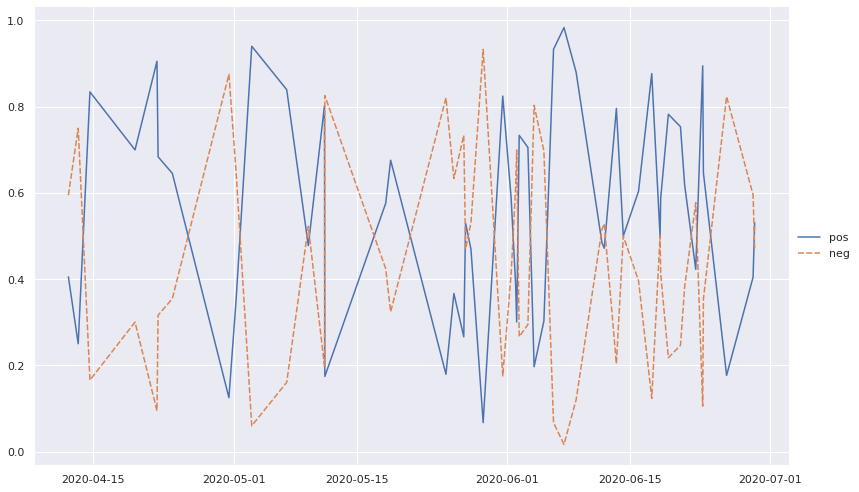

In [ ]:
sns.set(style="darkgrid")

palette = dict(zip(["pos","neg"],
                   sns.color_palette("gist_rainbow", 2)))

sns.relplot(data = posts_sample[["pos","neg"]],
            
            height=7, aspect=1.6, 
            kind="line", legend="full")

we can plot now the coroleation graph

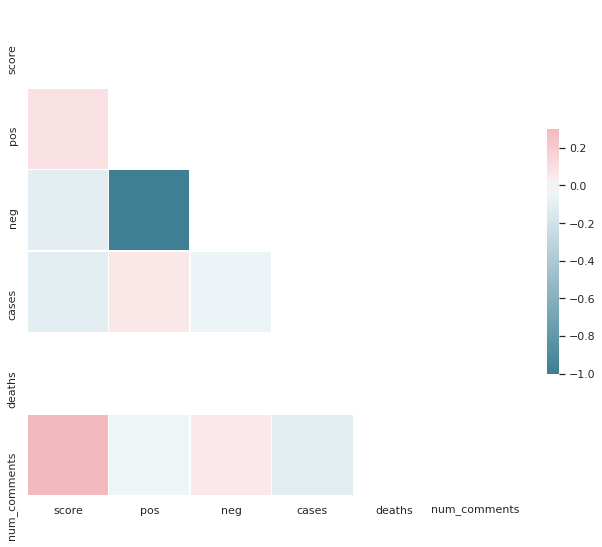

In [ ]:
sns.set(style="white")


corr = merge[["score","pos","neg","cases","deaths","num_comments"]].corr()

mask = np.triu(np.ones_like(corr, dtype=np.bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

we can see the coroleation between the pos neg titles and the deaths or cases in the population, this graph show no strong coroleation between the setmtiments of the comment and the cases or deaths in this day, the futre steps will be to add more titles to this anaylsis and try to do the same thing on the comment section.  

### **c. Unemployment Statistics**

**With limitless resources:**

Here I can take data from U.S bureadu of labor statistics about the unemployment rate in each country in the Utah state which will be my first dimenstion and compare the change over time, in addition we can see if the spread of the cases over countrys will correlate to the unemployment rate.
The second dimention will be by checking rate in the state over time in month resultion and year, then we will be able to see the total phenomena (all over the state).   

the data collection here will be done by scraping the bureadu of labor statistics website in Utah section, we assume that we will be able to build smarter scraping tool that can get acess to each country and pull the satistics.

In addtion we can take here spark streaming to store the live data streams, becouse this statisc will be change every day. 

In this demo we will take one dimention of this reasearch and check the unemployment rate changes over time.

**The demo include:**


*   build table scraping
*   overall labor force over time
*   1-D (time) plot for the unemployment rate
*   year histograms for unemployment rate





> build scraping



In [204]:
# Libray
import requests
import lxml.html as lh
import pandas as pd

url ="https://data.bls.gov/timeseries/LASST490000000000006?amp%253bdata_tool=XGtable&output_view=data&include_graphs=false"
#Create a handle, page, to handle the contents of the website
page = requests.get(url)
#Store the contents of the website under doc
doc = lh.fromstring(page.content)
#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')


In [ ]:
#For each row, store each first element (header) and an empty list
skipOn = 3
col = []
for t in tr_elements[skipOn-1]:
    name=t.text_content()
    col.append(name)
#fix parssing isues
col[0] = "Year"
col[1] = "Period"
df = pd.DataFrame(index=np.arange(len(tr_elements)-skipOn-1),columns = col)

In [236]:
index = 0
for row in tr_elements[3:-1]:
  row_data = []
  for item in row:
    row_data.append(item.text_content())
  df.loc[index] = row_data
  index+=1


,Year,Period,labor force participation rate,employment-population ratio,labor force,employment,unemployment,unemployment rate
0,2010,Jan,68.0,62.7,1355042,1247979,107063,7.9
1,2010,Feb,68.0,62.6,1355856,1248210,107646,7.9
2,2010,Mar,67.9,62.5,1356837,1248856,107981,8.0
3,2010,Apr,69.6,64.0,1357702,1249619,108083,8.0
4,2010,May,69.5,64.0,1358240,1250301,107939,7.9
...,...,...,...,...,...,...,...,...
120,2020,Jan,68.3,66.7,1626802,1586763,40039,2.5
121,2020,Feb,68.4,66.7,1630650,1590199,40451,2.5
122,2020,Mar,68.0,65.4,1625383,1562935,62448,3.8
123,2020,Apr,66.9,59.9,1600601,1434307,166294,10.4



> after geting data we can build the plot

we start with creating datatime column



In [252]:
import re

df["date"] = df["Period"] + " " + df["Year"]
df["date"] = df["date"].apply(lambda x : datetime.datetime.strptime(x, '%b %Y'))

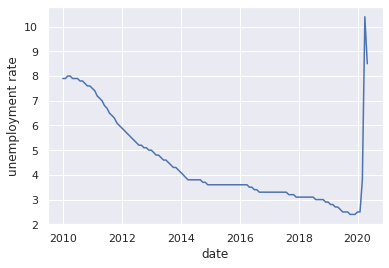

In [266]:
df["unemployment rate"] = df["unemployment rate"].apply(lambda x :float(re.findall("\d+\.\d+", str(x))[0]))

sns.lineplot(x="date", y="unemployment rate",
            
             data=df)

The plot above show the unemployment rate over all years from 2010

Now we can create zoom for the corona area in this timeline and check what happen after 2020 started (we take short time before corona statred)

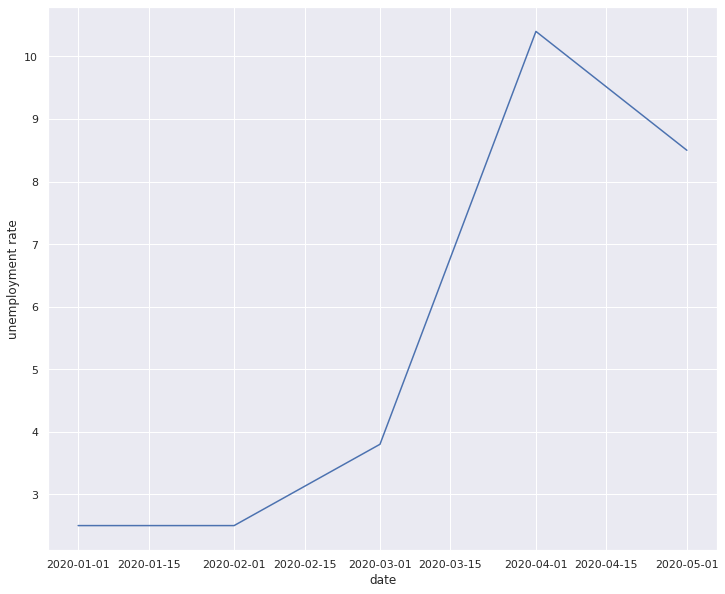

In [270]:
df_zoom = df[df["date"] >= '2020-01-01']

fig, ax = plt.subplots(figsize=(12,10))

sns.lineplot(ax = ax,x="date", y="unemployment rate",
            
             data=df_zoom)

In the above graph we can see the strong increase in the unemplyoment rate over the covid-19 area (mar - now)

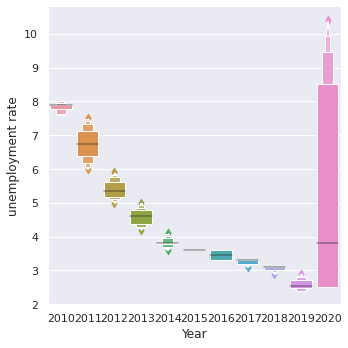

In [329]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline


df["employment-population ratio"] = df["employment-population ratio"].apply(lambda x :float(re.findall(r"[-+]?\d*\.\d+|\d+", str(x))[0]))
df["labor force participation rate"] = df["labor force participation rate"].apply(lambda x :float(re.findall(r"[-+]?\d*\.\d+|\d+", str(x))[0]))



sns.set(style="darkgrid")

sns.catplot(x="Year", y="unemployment rate", kind="boxen",
            data=df);

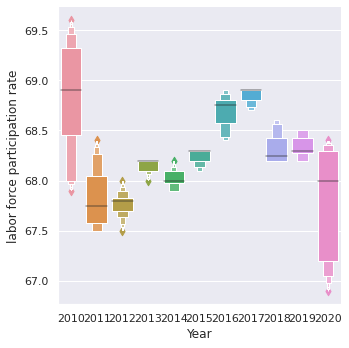

In [331]:
sns.catplot(x="Year", y="labor force participation rate", kind="boxen",
            data=df);

In conclusion, we can see diffrents patterns in the histogram of the unemployment rate comparing to labor force participation rate, this understing can may be indicate about diffrent reasons for the unemployment rate.

# Q2 - UFO

lets invistigate UFO in **Pennsylvania**


### **a. show with map the history of meeting with UFO over the year**

**In this demo**

We show the geo data by using choropleth_mapbox from plotly express and make a gif of the amount of event over time

**With limitless resources:**
In addtion we can create bigger dataset by scraping the social media and news site of UFO with keyword connected to UFO subject. To create grater visualization we could use kappler (better looking maps)


we need to save for each UFO event the the time and location and after that we will use heat map by 

In [ ]:
#!mkdir ./datasets
!mkdir ./datasets/ufo

# download the dataset from Kaggle and unzip it
!kaggle datasets download NUFORC/ufo-sightings  -p ./datasets/ufo

!unzip ./datasets/ufo/*.zip  -d ./datasets/ufo/

!pip install turicreate


In [ ]:
import turicreate as tc
import turicreate.aggregate as agg
import dateutil
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set()

sf = tc.SFrame.read_csv('./datasets/ufo/complete.csv')
df = sf.to_dataframe()

only Pennsylvania

In [211]:
df = df[df["state"] == "pa"]

In [212]:
import requests
import urllib
from tqdm import tqdm_notebook 

def lat_long_ToFips(lat, lon):
  #Encode parameters 
  params = urllib.parse.urlencode({'latitude': lat, 'longitude':lon, 'format':'json'})
  #Contruct request URL
  url = 'https://geo.fcc.gov/api/census/block/find?' + params

  #Get response from API
  response = requests.get(url)

  #Parse json in response
  data = response.json()

  #Print FIPS code
  return data['County']['FIPS']

fips = []
for index, r in tqdm_notebook(df.iterrows(),total=df.shape[0]):
  fips.append(lat_long_ToFips(r['latitude'],r['longitude']))

df["fips"] = fips


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:21: TqdmDeprecationWarning:

This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



get year from the datatime

In [213]:
df['year'] =  df['datetime'].apply(lambda x : int(str(x).split(' ')[0].split('/')[2]))
df = df.dropna()

df_counts = df.groupby(['year','fips']).size().reset_index(name='counts')

show gif

In [217]:
import numpy as np
from tqdm import tqdm
import plotly.express as px
import matplotlib.pyplot as plt
from urllib.request import urlopen
import json

df_counts['fips'] = df_counts['fips'].astype('int')
df_counts['year'] = df_counts['year'].astype(str)


with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)


allYears = df_counts["year"].unique()
paths = []
for year in tqdm(allYears):
  yearData = df_counts[df_counts["year"] == year]
  fig = px.choropleth_mapbox(yearData, geojson=counties, locations='fips', color='counts',
                              color_continuous_scale="Viridis",
                              range_color=(0, 12),
                              mapbox_style="carto-positron",
                              opacity=0.5,
                            )
  fig.update_layout(mapbox_zoom=5.5, mapbox_center = {"lat" : 40.925509,"lon": -77.754677}
                  ,font=dict(
                      family="Courier New, monospace",
                      size=10,
                      color="#7f7f7f"
                      ),
                  title={
                      'text': "Year: " + str(year),
                      'y':0.9,
                      'x':0.5,
                      'xanchor': 'center',
                      'yanchor': 'top',},
                  width=600,
                  height=500,
                  )
  fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
  path = f"images/fig{year}.png"
  fig.write_image(path)
  paths.append(path)

100%|██████████| 66/66 [05:18<00:00,  4.83s/it]


In [218]:
import imageio
images = []
for filename in paths:
    images.append(imageio.imread(filename))
imageio.mimsave("./images/all_year.gif", images, duration=1 )

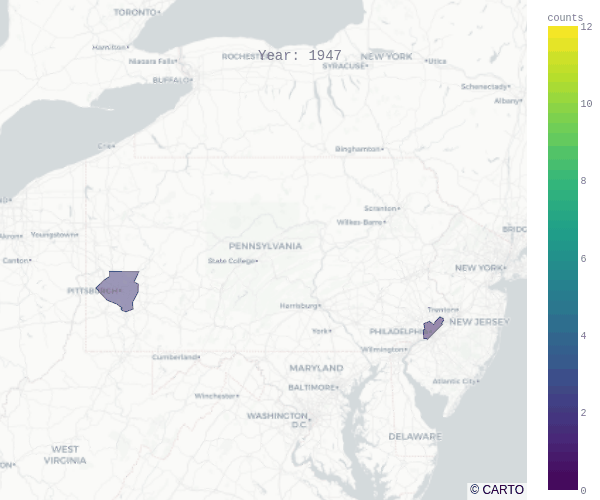

In [219]:
from IPython.display import Image
Image('./images/all_year.gif', format='png')

along the year we can see increase in the amount of the events, and some location repat many time among the year like Pittsburgh area

**need to add years**

### **b. detect  diffrent mettings**

The idea here is to create graph with similarity parameter as the link, we going to create the graph with TH and if 2 events have similarity bigger then the TH we will link them.
After that we can create comunitys and check which events not in the same comunity.

The step in this analysis will be:


*   create function for similarity parameter
*   check which event passed TH and link them
*   create communitys
*   show graph of comunitys and exemples


**In the demo**

similarity parameter will be compute by see how many entinty 2 event have,if they saw the same shape and if they saw the event in the same year .


**with limiless resources**

I could create better similarity parameter by adding:

*   distance for the word embading vector for comments of diffrent events

*   time diff calculation of the events 

*   location distance, if the location of 2 events is similar the similarity parameter grater

Beside of comunity in the graph I could sort the tuples of the events and see directly who have the biggest and the lowest similarity parameter.

Or use some ML algo for clustring by    active embeding algorithem with karateclub, now we can use K-mean algorithem for finding clusters and see which events are in the same cluster or not. 

**This explanation is the same for section "b" and "c"**




In [ ]:
import spacy
import pandas as pd
from tqdm import tqdm_notebook
import networkx as nx

sf = tc.SFrame.read_csv('./datasets/ufo/complete.csv')
df = sf.to_dataframe()

df = df[df["state"] == "pa"]
df['year'] =  df['datetime'].apply(lambda x : int(str(x).split(' ')[0].split('/')[2]))

df = df.reset_index()

In [10]:
nlp = spacy.load('en')

def get_entites_from_text(text):
    entities_dict= {}
    #using spaCy to get entities
    doc = nlp(text)
    for entity in doc.ents:
        label = entity.label_
        if  label not in entities_dict:
            entities_dict[label] = set()
        entities_dict[label].add(entity.text)        

    return entities_dict

def entites_to_list(all_entites):
  entetis = []
  for i in all_entites.values():
    entetis.extend([j for j in list(i)])
  entetis = [i.lower() for i in entetis]
  return entetis

def calcSimilarity(eventA,eventB):
  score = 0
  #shape score
  if (eventA["shape"] == eventB["shape"]):
    score+=1
  #similar entites
  entetisA = entites_to_list(get_entites_from_text(eventA["comments"]))
  entetisB = entites_to_list(get_entites_from_text(eventB["comments"]))
  score+=len(set(entetisA).union(set(entetisB)))
  #year score
  if (eventA["year"] == eventB["year"]):
    score+=1
  return score
## we needed to take less data becouse the method took alot of tame due to the spacy
## library 
length = len(df)-2700

index = 0
scoreDF = pd.DataFrame(columns=['eventA_ID', 'eventB_ID', 'score'])
for eventA_ID in tqdm_notebook(range(length)):
  for eventB_ID in range(eventA_ID,length):
    scoreDF.loc[index] = [str(eventA_ID),str(eventB_ID)] + [calcSimilarity(df.iloc[eventA_ID],df.iloc[eventB_ID])]
    index+=1

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


we can see that almost half are above score of 3 so we can take them and create graph from them.

**so our TH will be 3 in the similarity score**

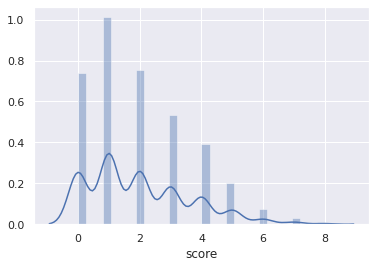

In [74]:
ax = sns.distplot(scoreDF.score)


> create graph



In [13]:
import networkx as nx
import numpy as np

nodes = np.arange(length)

TH =3
scoreDF_TH = scoreDF[scoreDF["score"]>= TH]

G=nx.from_pandas_edgelist(scoreDF_TH, 'eventA_ID', 'eventB_ID')

In [97]:
from networkx.algorithms import community
communities = community.kernighan_lin_bisection(G)

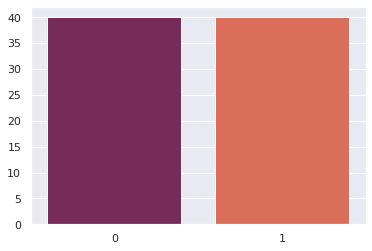

In [98]:
countCommunities = [len(i) for i in communities]
sns.barplot(x=np.arange(len(countCommunities)), y=countCommunities, palette="rocket")


now we can look on two events from diffrent comunitys and check how they look 

In [101]:
df.loc[int(list(communities[0])[0])]

index                                                                 484
datetime                                                 10/11/2012 21:00
city                                                            levittown
state                                                                  pa
country                                                                us
shape                                                             diamond
duration (seconds)                                                     60
duration (hours/min)                                             1 minute
comments                About 9:00 pm&#44 Oct. 11&#44 2012&#44 driving...
date posted                                                    10/30/2012
latitude                                                           40.155
longitude                                                        -74.8292
year                                                                 2012
Name: 10, dtype: object

In [117]:
print("communitie A")
print(f"comment: {df.loc[int(list(communities[1])[0])]['comments']}")
print(f"shape: {df.loc[int(list(communities[1])[0])]['shape']}")
print(f"year: {df.loc[int(list(communities[1])[0])]['year']}")
print("communitie B")
print(f"comment: {df.loc[int(list(communities[0])[0])]['comments']}")
print(f"shape: {df.loc[int(list(communities[0])[0])]['shape']}")
print(f"year: {df.loc[int(list(communities[0])[0])]['year']}")

communitie A
comment: We saw craft at close range with all detail on a clear sunny day at 12:00 noon.
shape: other
year: 2008
communitie B
comment: About 9:00 pm&#44 Oct. 11&#44 2012&#44 driving home I first heard strange high-pitched siren-like sound&#44 and rolled down my window to hear what
shape: diamond
year: 2012


### **c. find same events from diffrent states**

In this section we going to use the same algorithem from section "b" but now we will find events in the same community. 

In [ ]:
sf = tc.SFrame.read_csv('./datasets/ufo/complete.csv')
df = sf.to_dataframe()

closestStates = ["oh","wv","de","ny"]

df = df[df["state"].isin( closestStates+["pa"])]
df['year'] =  df['datetime'].apply(lambda x : int(str(x).split(' ')[0].split('/')[2]))

df = df.sample(frac=1).reset_index(drop=True)




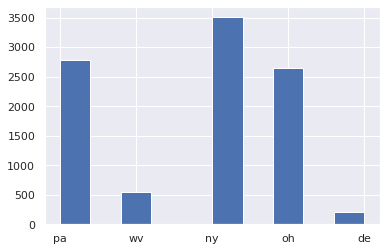

In [133]:
x = df.state.hist()

becouse most 

In [140]:
from collections import Counter
counterState = dict(Counter(df.state))
minCount = min(list(counterState.values()))
states = list(counterState.keys())

newDf = pd.DataFrame(columns=df.columns)
for state in states:
  df_temp = df[df["state"] == state]
  df_temp = df_temp.sample(minCount)
  newDf = pd.concat([newDf,df_temp])

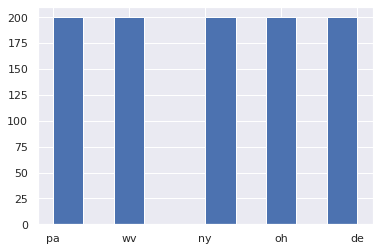

In [163]:
x = newDf.state.hist()

In [174]:
newDf = newDf.sample(frac=1).reset_index(drop=True)

In [176]:
length = len(newDf)-900

index = 0
scoreDF = pd.DataFrame(columns=['eventA_ID', 'eventB_ID', 'score'])
for eventA_ID in tqdm_notebook(range(length)):
  for eventB_ID in range(eventA_ID,length):
    scoreDF.loc[index] = [str(eventA_ID),str(eventB_ID)] + [calcSimilarity(newDf.iloc[eventA_ID],newDf.iloc[eventB_ID])]
    index+=1

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: TqdmDeprecationWarning:

This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



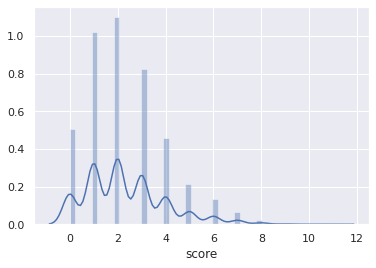

In [177]:
ax = sns.distplot(scoreDF.score)

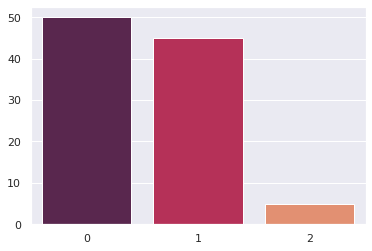

In [178]:
import networkx as nx

nodes = np.arange(length)

TH =3
scoreDF_TH = scoreDF[scoreDF["score"]>= TH]

G=nx.from_pandas_edgelist(scoreDF_TH, 'eventA_ID', 'eventB_ID')

from networkx.algorithms import community
communities = community.greedy_modularity_communities(G)

countCommunities = [len(i) for i in communities]
sns.barplot(x=np.arange(len(countCommunities)), y=countCommunities, palette="rocket")


In [187]:
print("communitie A")
i =7
print(f"comment: {newDf.iloc[int(list(communities[1])[i])]['comments']}")
print(f"shape: {newDf.iloc[int(list(communities[1])[i])]['shape']}")
print(f"year: {newDf.iloc[int(list(communities[1])[i])]['year']}")
print(f"state: {newDf.iloc[int(list(communities[1])[i])]['state']}")
print()
print(f"comment: {newDf.iloc[int(list(communities[1])[0])]['comments']}")
print(f"shape: {newDf.iloc[int(list(communities[1])[0])]['shape']}")
print(f"year: {newDf.iloc[int(list(communities[1])[0])]['year']}")
print(f"state: {newDf.iloc[int(list(communities[1])[0])]['state']}")

communitie A
comment: group of reddish lights flying over a residential neighborhood.
shape: light
year: 2010
state: de

comment: Blue/Green light seen by 2 people. Myself and my husband which he is a AF Reservist.
shape: light
year: 2011
state: oh


In [213]:
print("communitie B")
print("communitie A")
i =33
print(f"comment: {newDf.iloc[int(list(communities[0])[i])]['comments']}")
print(f"shape: {newDf.iloc[int(list(communities[0])[i])]['shape']}")
print(f"year: {newDf.iloc[int(list(communities[0])[i])]['year']}")
print(f"state: {newDf.iloc[int(list(communities[0])[i])]['state']}")
print()
print(f"comment: {newDf.iloc[int(list(communities[0])[13])]['comments']}")
print(f"shape: {newDf.iloc[int(list(communities[0])[13])]['shape']}")
print(f"year: {newDf.iloc[int(list(communities[0])[13])]['year']}")
print(f"state: {newDf.iloc[int(list(communities[0])[13])]['state']}")

communitie B
communitie A
comment: 4 lights in square formation in sky and small triangular craft seen at close range
shape: triangle
year: 1997
state: de

comment: Four fireballs in the night sky.
shape: fireball
year: 2013
state: pa


we can see in the fist caple same shape and in the comment we see talking about colors and maybe multiple objects.

In the second exmple we see same number in the comment

### **d. anomaly detection**


**in the demo**

We will use in this section pagerank, this centrality megerment will help us to understand which event ranks low.

In this section I will use the same graph of section "b", each link indicate similarity and the event with low rank will considerd as diffrent

**with limiless resources**
In addtion to the pagerank we can use: 


*   degree_centrality
*   eigenvector_centrality
*   closeness_centrality

After having many Centrality meagerment we can find which events found in the lowest place for most of them and have more confident.




In [14]:
import operator
import collections
import matplotlib.pyplot as plt
import networkx as nx
pr = nx.pagerank(G)
sorted_pr = dict(sorted(pr.items(), key=operator.itemgetter(1)))
sorted_pr = collections.OrderedDict(sorted_pr)


we can show bar plot of the ranks

Text(0, 0.5, 'pageRank')

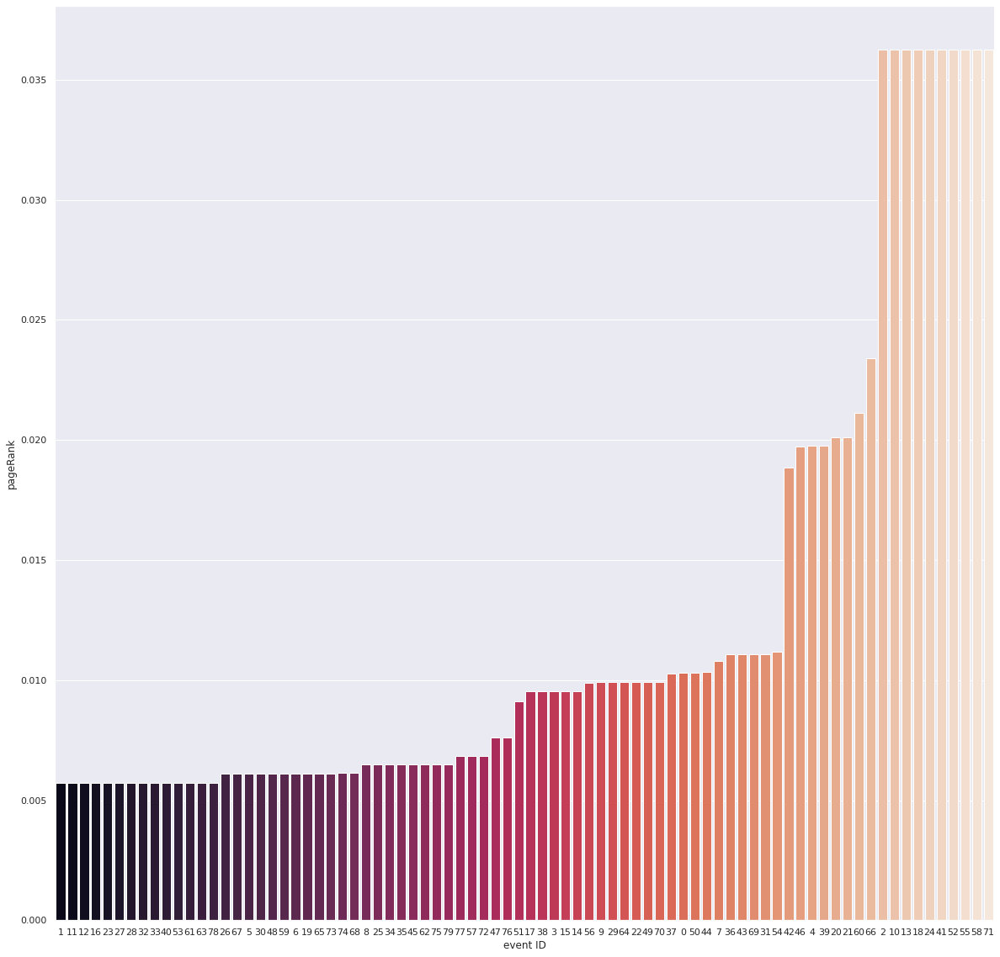

In [16]:
plt.figure(figsize=(20,20))

ax =sns.barplot(x=list(sorted_pr.keys()), y=list(sorted_pr.values()), palette="rocket",order=list(sorted_pr.keys()))
plt.xlabel("event ID")
plt.ylabel("pageRank")

In [21]:
top = 5
eventsID = list(sorted_pr.keys())[:top]

index = 0
for i in eventsID:
  index+=1
  i  = int(i)
  print(f"top anomaly {index}")
  print(f"comment: {df.iloc[i]['comments']}")
  print(f"shape: {df.iloc[i]['shape']}")
  print(f"year: {df.iloc[i]['year']}")



top anomaly 1
comment: Dull red flash&#44 Triangular ship&#44 Vocal Noises
shape: triangle
year: 2005
top anomaly 2
comment: It could move very slowly or very quickly but either way it moved without making any noise.
shape: disk
year: 1965
top anomaly 3
comment: Disk appeared over stadium at end of game... spun like a coin on a table...game ended ... never heard a thing about it.
shape: disk
year: 1979
top anomaly 4
comment: Low flying rectangular object with very bright lights on all sides.
shape: rectangle
year: 1995
top anomaly 5
comment: Low UFO sliding out of a cloud into clear blue sky.
shape: disk
year: 1965


We can see in the above some anomaly events that our alogrithm found, for exmple we can see rank 3 with comment about a game he saw in the middle of the event, this can be spacial addtion that we will not see in other comment area.


### **e. intresting patterns**

**In the demo**

We going to create word cloud to check cool patterns in the entetis of the comment section

**with limiless resources**


*   Create map with animation over time for the shape and location and see if we can see some pattern in the sape over the year 


*   Use sentiment analysis for each comment and see how posative values distribute over time, country or both by use map animation.

In [ ]:
sf = tc.SFrame.read_csv('./datasets/ufo/complete.csv')
df = sf.to_dataframe()

df = df[df["state"] == "pa"]

In [9]:
import spacy 
from tqdm import tqdm_notebook
nlp = spacy.load('en')

def get_entites_from_text(text):
    entities_dict= {}
    #using spaCy to get entities
    doc = nlp(text)
    for entity in doc.ents:
        label = entity.label_
        if  label not in entities_dict:
            entities_dict[label] = set()
        entities_dict[label].add(entity.text)        

    return entities_dict

def entites_to_list(all_entites):
  entetis = []
  for i in all_entites.values():
    entetis.extend([j for j in list(i)])
  entetis = [i.lower() for i in entetis]
  return entetis

def get_all_enteties(eventA):
  entetisA = entites_to_list(get_entites_from_text(eventA["comments"]))
  return entetisA


length = len(df)

index = 0
text = []
for eventA_ID in tqdm_notebook(range(length)):
    text.extend(get_all_enteties(df.iloc[eventA_ID]))


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:33: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


'3 triangular pd nuforc note brighter contrail grove city 60 pittsburgh international airport bright lit orb speeds across s.central pa nanticoke pa about 9:00 oct. 2012 first the year the late 1970-s shirleysburg pa eight 44 morning westmoreland &amp allegheny county 6 the glenfied bridge ohio pd nuforc note about 500 feet three 3 one cigar 12:00 noon four stange craft 1 blue mt. 2 yellowish orange brilliant red oval port richmond philadelphia 2 orange/amber lights yellow 4 the night 4 interstate 81 white  harrisburg pa two 15 minutes later october 14th 2008 triangle 20-30 minutes northampton county two 4x a clear night october about 1994 white &#8220;star aurora borealis eight three a few years ago i&#39ve about a quarter oval january &amp october 1992 bates &amp mckee pittsburgh pa autumn night 3 4 2 3 side &amp 4 1-2 minutes 10/ 19/09 2 80 3 night 3 north pennsylvania hoax angeld house 5 nights fro two ice mountain two 5 2 jupiter 2 4 allentown pennsylvania 4 burnt orange levittown

<Figure size 432x288 with 0 Axes>

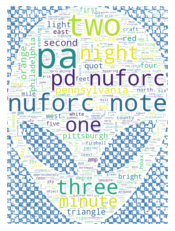

<Figure size 432x288 with 0 Axes>

In [22]:
from wordcloud import WordCloud, STOPWORDS
import numpy as np
from PIL import Image

text_union = " ".join(text).replace("&#44","")

alien_mask = np.array(Image.open("./alien_mask.jpg"))

stopwords = set(STOPWORDS)
stopwords.add("said")

wc = WordCloud(background_color="white", max_words=2000, mask=alien_mask,
               stopwords=stopwords, contour_width=3, contour_color='steelblue')

# generate word cloud
wc.generate(text_union)

# show
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.figure()

We can see some cool words in our amazing alien cloud:


*   NUFORC - National UFO reporting center
*   night
*   word as number (indicate about how many object they saw)
*   light
*   pennsylvania



In addtion we can take this words in the future and see which claster in our graph from previues sections indentify by them.
We can check this word cloud for all the table to for each state and check which word represnt which state.

# Q3 - help business in COVID-19

My idea here is to create mask face classification for the busniess who open in the open area.

**Motivation:**

Most of the busniess have limtiless capability to contain all the people in the duo to limitless space, In addtion in the covid-19 area we have additional limitations for the amount of pepole that can be inside the store. This effect couse to larger queue so want to know if all the pepole in our queue wear mask and detect if someone dont ware mask.

**Method**

I will start with pull many images from multiple resources with lables, this images need to contain many faces with masks and and images of many people without mask, after that I will need to use face_recognition to detect the face and cut it to diffrent image with label.
The last step is to train CNN model with all the faces and the lables.

Now when the camera of the store get frame I will be able cut all faces from the frame and locate if one of them is without the mask.

In addtion to this model I want to create popup plug-in to the busniess computers and app for the phone to notify if the classfier dont see pepole.
If we want to be able notify only when the app found pepole without mask we need to teach it in the begging to found pepole and only after that to classify if they wear masks.


**Demo**

In this demo I got data from kaggle which contain images of people with and without mask, so I can create dataset of face and label, in the real product I will need to detect the face firstly with face_detection library and then active my mask detection.

**Structure**
![](https://drive.google.com/uc?id=14Ax6NCdtMMPdRg6KJYePU3ig9s_-InmR)


*All the pink modules will be Implemented in my demo.*

In [ ]:
!mkdir ./datasets
!kaggle datasets download -d andrewmvd/face-mask-detection -p ./datasets
#!kaggle datasets download -d lsind18/gemstones-images -p ./datasets
!unzip ./datasets/face-mask-detection.zip  -d ./datasets/

starting with bring the xml data and convert it to dataframe

In [70]:
import os
import xml.etree.ElementTree as et
import re
import pandas as pd

maxNumOfObj = 116
dic = {"image": [],"Dimensions": []}
for i in range(1,maxNumOfObj):
	dic[f'Object {i}']=[]

for file in os.listdir("./datasets/annotations"):
    row = []
    xml = et.parse("./datasets/annotations/"+file) 
    root = xml.getroot()
    img = root[1].text
    row.append(img)
    h,w = root[2][0].text,root[2][1].text
    row.append([h,w])

    for i in range(4,len(root)):
        temp = []
        temp.append(root[i][0].text)
        for point in root[i][5]:
            temp.append(point.text)
        row.append(temp)
    for i in range(len(row),119):
        row.append(0)
    for i,each in enumerate(dic):
        dic[each].append(row[i])
df = pd.DataFrame(dic)
df.head()


,image,Dimensions,Object 1,Object 2,Object 3,Object 4,Object 5,Object 6,Object 7,Object 8,Object 9,Object 10,Object 11,Object 12,Object 13,Object 14,Object 15,Object 16,Object 17,Object 18,Object 19,Object 20,Object 21,Object 22,Object 23,Object 24,Object 25,Object 26,Object 27,Object 28,Object 29,Object 30,Object 31,Object 32,Object 33,Object 34,Object 35,Object 36,Object 37,Object 38,...,Object 76,Object 77,Object 78,Object 79,Object 80,Object 81,Object 82,Object 83,Object 84,Object 85,Object 86,Object 87,Object 88,Object 89,Object 90,Object 91,Object 92,Object 93,Object 94,Object 95,Object 96,Object 97,Object 98,Object 99,Object 100,Object 101,Object 102,Object 103,Object 104,Object 105,Object 106,Object 107,Object 108,Object 109,Object 110,Object 111,Object 112,Object 113,Object 114,Object 115
0,maksssksksss63.png,"[400, 226]","[with_mask, 131, 86, 259, 216]",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,maksssksksss91.png,"[400, 225]","[with_mask, 62, 11, 96, 52]","[with_mask, 111, 48, 169, 115]","[with_mask, 200, 1, 248, 43]","[with_mask, 244, 65, 305, 141]","[with_mask, 290, 101, 342, 185]",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,maksssksksss333.png,"[301, 400]","[with_mask, 76, 203, 181, 330]",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,maksssksksss499.png,"[400, 226]","[without_mask, 101, 24, 132, 62]","[with_mask, 222, 44, 253, 77]",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,maksssksksss518.png,"[400, 225]","[with_mask, 3, 112, 12, 122]","[with_mask, 27, 178, 35, 186]","[with_mask, 25, 107, 35, 117]","[with_mask, 51, 108, 61, 120]","[without_mask, 43, 137, 53, 148]","[without_mask, 63, 156, 71, 166]","[with_mask, 49, 80, 59, 90]","[with_mask, 72, 82, 77, 92]","[without_mask, 55, 57, 64, 66]","[with_mask, 34, 31, 41, 40]","[with_mask, 104, 149, 116, 162]","[with_mask, 130, 196, 143, 209]","[with_mask, 117, 135, 127, 147]","[without_mask, 116, 105, 124, 114]","[with_mask, 107, 89, 115, 99]","[with_mask, 146, 106, 154, 116]","[with_mask, 152, 152, 164, 164]","[with_mask, 167, 177, 178, 191]","[with_mask, 154, 174, 166, 188]","[with_mask, 190, 202, 197, 212]","[with_mask, 192, 142, 203, 155]","[with_mask, 184, 133, 197, 141]","[with_mask, 176, 98, 187, 108]","[with_mask, 139, 80, 150, 90]","[with_mask, 89, 56, 98, 63]","[without_mask, 85, 46, 93, 55]","[without_mask, 107, 57, 117, 67]","[without_mask, 122, 52, 130, 60]","[with_mask, 149, 58, 158, 67]","[with_mask, 140, 43, 150, 52]","[with_mask, 108, 15, 115, 23]","[with_mask, 123, 8, 129, 16]","[with_mask, 133, 34, 140, 42]","[with_mask, 163, 33, 171, 40]","[with_mask, 99, 43, 106, 51]","[with_mask, 171, 81, 181, 90]","[with_mask, 186, 67, 195, 78]","[with_mask, 199, 78, 208, 88]",...,"[with_mask, 379, 54, 384, 60]","[with_mask, 365, 81, 375, 91]","[with_mask, 378, 99, 388, 108]","[with_mask, 384, 65, 392, 75]","[with_mask, 341, 15, 347, 21]","[with_mask, 392, 147, 400, 159]","[with_mask, 391, 127, 400, 138]","[with_mask, 372, 112, 381, 120]",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Detect image by the data with the object_x columns and the bounders and set label.

In [ ]:
!mkdir datasets/afterProcessImg
import cv2

def cropImageAndSave(name,size,id):
  img = cv2.imread(f"./datasets/images/{name}")
  crop_img = img[size[1]:size[3], size[0]:size[2]]
  cv2.imwrite(f'./datasets/afterProcessImg/img{id}.jpg',crop_img)

def getListOfObjestsForRow(row):
  allObj = []
  for i in range(1,maxNumOfObj):
    if row[f"Object {i}"] != 0 :
      allObj.append(row[f"Object {i}"])
  return allObj

id = 0
labelDf = pd.DataFrame(columns = ["image","label"])
for index,row in df.iterrows():
  allObj = getListOfObjestsForRow(row)
  imgName = row["image"]
  for obj in allObj:
    sizes = list(map(int,obj[1:]))
    cropImageAndSave(imgName,sizes,id)
    labelDf.loc[id] = [f"img{id}.jpg",obj[0]]
    id+=1

this model will have bias but in our demo we will fix it with the easy way and delete some "with mask" labels, in the real product we will need to genrate varition for "witout_mask" and "mask_weared_incorrect" by changaing rotation, size and colors.

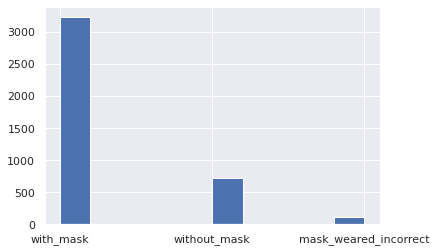

In [98]:
labelDf.label.hist()

load to sframe and correct bias lables

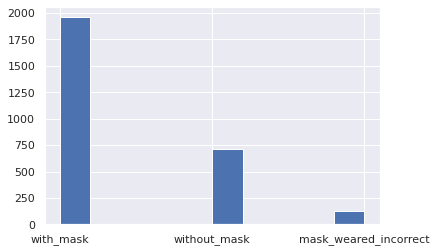

In [203]:
import turicreate as tc

DATASET_PATH = "./datasets/afterProcessImg"


data = tc.image_analysis.load_images(f"{DATASET_PATH}", with_path=True)
data["label"] = labelDf["label"]

df_withMask = data[data["label"] == "with_mask"].sample(fraction=0.6, seed=1)
data = df_withMask.append(data[data["label"] != "with_mask"])

data.to_dataframe().label.hist()

/usr/local/lib/python3.6/dist-packages/turicreate/visualization/_plot.py:461: UserWarning:

Displaying only the first 100 rows.



,path,image,label
0,/content/datasets/afterProcessImg/img1011.jpg,,with_mask
1,/content/datasets/afterProcessImg/img1014.jpg,,with_mask
2,/content/datasets/afterProcessImg/img1016.jpg,,with_mask
3,/content/datasets/afterProcessImg/img1019.jpg,,with_mask
4,/content/datasets/afterProcessImg/img1020.jpg,,with_mask
5,/content/datasets/afterProcessImg/img1021.jpg,,with_mask
6,/content/datasets/afterProcessImg/img1024.jpg,,with_mask
7,/content/datasets/afterProcessImg/img1035.jpg,,with_mask
8,/content/datasets/afterProcessImg/img1038.jpg,,with_mask
9,/content/datasets/afterProcessImg/img1040.jpg,,with_mask

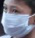
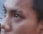
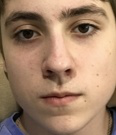
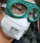
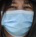
...
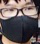
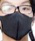
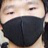
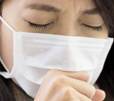
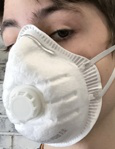

In [161]:
data.explore()

In [204]:
train, test = data.random_split(0.8)
model = tc.image_classifier.create(train['image','label'], target='label')

Performing feature extraction on resized images...
Completed   64/2249
Completed  128/2249
Completed  192/2249
Completed  256/2249
Completed  320/2249
Completed  384/2249
Completed  448/2249
Completed  512/2249
Completed  576/2249
Completed  640/2249
Completed  704/2249
Completed  768/2249
Completed  832/2249
Completed  896/2249
Completed  960/2249
Completed 1024/2249
Completed 1088/2249
Completed 1152/2249
Completed 1216/2249
Completed 1280/2249
Completed 1344/2249
Completed 1408/2249
Completed 1472/2249
Completed 1536/2249
Completed 1600/2249
Completed 1664/2249
Completed 1728/2249
Completed 1792/2249
Completed 1856/2249
Completed 1920/2249
Completed 1984/2249
Completed 2048/2249
Completed 2112/2249
Completed 2176/2249
Completed 2240/2249
Completed 2249/2249
PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.



Logistic regression:

--------------------------------------------------------

Number of examples          : 2136

Number of classes           : 3

Number of feature columns   : 1

Number of unpacked features : 2048

Number of coefficients      : 4098

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 6        | 0.007811  | 0.986756     | 0.697566          | 0.716814            |

| 1         | 13       | 1.663708  | 2.278180     | 0.697566          | 0.716814            |

| 2         | 14       | 1.663708  | 2.635946     | 0.697566          | 0.716814            |

| 3         | 15       | 1.663708  | 3.018092     | 0.697566          | 0.716814            |

| 4         | 17       | 1.418234  | 3.524964     | 0.697566          | 0.716814            |

| 9         | 23       | 0.950071  | 5.486225     | 0.710674          | 0.716814            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

**evalution**

In [205]:
test['prediction'] = model.predict(test)
from sklearn.metrics import accuracy_score
accuracy_score(list(test['label']), list(test['prediction']))

0.6878402903811253

we got this score on the test, I assume that if we will try to do better preprocess with the bias of the labels and biger data set we will be able to get better results.

lets see some of the predction..

mkdir: cannot create directory ‘./datasets/predictedImg’: File exists


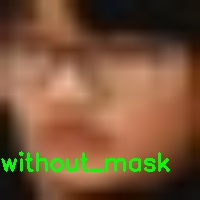

In [206]:
!mkdir ./datasets/predictedImg
from IPython.display import Image

def showImageWithLabel(img,label):
  img = cv2.imread(img)
  img = cv2.resize(img, (200,200)) 
  font                   = cv2.FONT_HERSHEY_SIMPLEX
  bottomLeftCornerOfText = (0,170)
  fontScale              = 0.8
  fontColor              = (0,255,0)
  lineType               = 2

  cv2.putText(img,label, 
      bottomLeftCornerOfText, 
      font, 
      fontScale,
      fontColor,
      lineType)

  cv2.imwrite("./datasets/predictedImg/out.jpg", img)

index = 2
showImageWithLabel(test["path"][index],test["prediction"][index])
Image("./datasets/predictedImg/out.jpg")

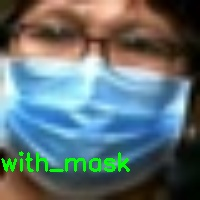

In [208]:
index = 0
test_without = test[test["label"] == "with_mask"]
showImageWithLabel(test_without["path"][index],test_without["prediction"][index])
Image("./datasets/predictedImg/out.jpg")